##### Copyright 2018 Google LLC.

Licensed under the Apache License, Version 2.0 (the "License");

In [2]:
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# Install / Import / Load

This code depends on [Lucid](https://github.com/tensorflow/lucid) (our visualization library), and [svelte](https://svelte.technology/) (a web framework). The following cell will install both of them, and dependancies such as TensorFlow. And then import them as appropriate.

In [3]:
#!npm install -g svelte-cli@2.2.0
#!pip install --user scikit-image

import numpy as np
import tensorflow as tf
from skimage.transform import resize
from skimage.io import imsave

import lucid.modelzoo.vision_models as models
from lucid.misc.io import show
import lucid.optvis.render as render
from lucid.misc.io import show, load
from lucid.misc.io.reading import read
from lucid.misc.io.showing import _image_url
from lucid.misc.gradient_override import gradient_override_map
import lucid.scratch.web.svelte as lucid_svelte

from top5gen.examples.inception_pretrained import get_top_five

Instructions for updating:
`normal` is a deprecated alias for `truncated_normal`


Instructions for updating:
`normal` is a deprecated alias for `truncated_normal`


# Attribution Code

In [4]:
# This, obviously, loads up the model
model = models.InceptionV1()
model.load_graphdef()

In [5]:
# Here we take in the 1000-dimension vector of potential image labels
labels_str = read("https://gist.githubusercontent.com/aaronpolhamus/964a4411c0906315deb9f4a3723aac57/raw/aa66dd9dbf6b56649fa3fab83659b2acbf3cbfd1/map_clsloc.txt")
labels = [line[line.find(" "):].strip().encode() for line in labels_str.decode().split("\n")]
labels = [label.decode().strip().split()[1].replace("_", " ") for label in labels]
labels = ["dummy"] + labels

In [6]:
def raw_class_spatial_attr(img, layer, label, override=None):
  """How much did spatial positions at a given layer effect a output class?"""

  # Set up a graph for doing attribution...
  with tf.Graph().as_default(), tf.Session(), gradient_override_map(override or {}):
    t_input = tf.placeholder_with_default(img, [None, None, 3])
    T = render.import_model(model, t_input, t_input)
    
    # Compute activations
    acts = T(layer).eval()
    
    # display results

    
    if label is None: return np.zeros(acts.shape[1:-1])
    
    # Compute gradient
    softmax_result = T("softmax2_pre_activation")
    score = softmax_result[0, labels.index(label)] # The "score" is the softmax result at idx [0, label idx]
    t_grad = tf.gradients([score], [T(layer)])[0]   
    grad = t_grad.eval({T(layer) : acts})
    
    # Linear approximation of effect of spatial position
    return np.sum(acts * grad, -1)[0]

In [7]:
def raw_spatial_spatial_attr(img, layer1, layer2, override=None):
  """Attribution between spatial positions in two different layers."""

  # Set up a graph for doing attribution...
  with tf.Graph().as_default(), tf.Session(), gradient_override_map(override or {}):
    t_input = tf.placeholder_with_default(img, [None, None, 3])
    T = render.import_model(model, t_input, t_input)
    
    # Compute activations
    acts1 = T(layer1).eval()
    acts2 = T(layer2).eval({T(layer1) : acts1})
    
    # Construct gradient tensor
    # Backprop from spatial position (n_x, n_y) in layer2 to layer1.
    n_x, n_y = tf.placeholder("int32", []), tf.placeholder("int32", [])
    layer2_mags = tf.sqrt(tf.reduce_sum(T(layer2)**2, -1))[0]
    score = layer2_mags[n_x, n_y]
    t_grad = tf.gradients([score], [T(layer1)])[0]
    
    # Compute attribution backwards from each positin in layer2
    attrs = []
    for i in range(acts2.shape[1]):
      attrs_ = []
      for j in range(acts2.shape[2]):
        grad = t_grad.eval({n_x : i, n_y : j, T(layer1) : acts1})
        # linear approximation of imapct
        attr = np.sum(acts1 * grad, -1)[0]
        attrs_.append(attr)
      attrs.append(attrs_)
  return np.asarray(attrs)

# Spatial Attribution Interface

In this section, we build the *interface* for interacting with the different kinds of spatial attribution data that we can compute using the above functions. Feel free to skip over this if you aren't interested in that part. The main reason we're including it is so that you can change the interface if you want to.


In [8]:
%%html_define_svelte SpatialWidget

<div class="figure" style="width: 10000px; height: 250px; contain: strict;">
  <div class="outer" on:mouseleave="set({pos2: undefined})">
    <img class="img"  src="{{img}}">
    <img class="attr" src="{{(pos1 == undefined)? hint1 : spritemap1[pos1[1]][pos1[0]]}}">

    <div class="label">mixed3a {{pct1}}</div>
  </div>

  <div class="outer" on:mouseleave="set({pos2: undefined})">
    <img class="img"  src="{{img}}">
    <img class="attr" src="{{(pos1 == undefined)? hint2 : spritemap1[pos1[1]][pos1[0]]}}">

    <div class="label">mixed3b {{pct2}}</div>
  </div>  

  <div class="outer" on:mouseleave="set({pos2: undefined})">
    <img class="img"  src="{{img}}">
    <img class="attr" src="{{(pos1 == undefined)? hint3 : spritemap1[pos1[1]][pos1[0]]}}">

    <div class="label">mixed4a {{pct3}}</div>
  </div>

  <div class="outer" on:mouseleave="set({pos2: undefined})">
    <img class="img"  src="{{img}}">
    <img class="attr" src="{{(pos1 == undefined)? hint4 : spritemap1[pos1[1]][pos1[0]]}}">

    <div class="label">mixed4b {{pct4}}</div>
  </div>  

  <div class="outer" on:mouseleave="set({pos2: undefined})">
    <img class="img"  src="{{img}}">
    <img class="attr" src="{{(pos1 == undefined)? hint5 : spritemap1[pos1[1]][pos1[0]]}}">

    <div class="label">mixed4c {{pct5}}</div>
  </div>

 <div class="outer" on:mouseleave="set({pos2: undefined})">
    <img class="img"  src="{{img}}">
    <img class="attr" src="{{(pos1 == undefined)? hint6 : spritemap1[pos1[1]][pos1[0]]}}">

    <div class="label">mixed4d {{pct6}}</div>
  </div>

  <div class="outer" on:mouseleave="set({pos2: undefined})">
    <img class="img"  src="{{img}}">
    <img class="attr" src="{{(pos1 == undefined)? hint6 : spritemap1[pos1[1]][pos1[0]]}}">

    <div class="label">mixed4e {{pct7}}</div>
  </div>  

  <div class="outer" on:mouseleave="set({pos2: undefined})">
    <img class="img"  src="{{img}}">
    <img class="attr" src="{{(pos1 == undefined)? hint8 : spritemap1[pos1[1]][pos1[0]]}}">

    <div class="label">mixed5a {{pct8}}</div>
  </div>

    <div class="outer" on:mouseleave="set({pos2: undefined})">
    <img class="img"  src="{{img}}">
    <img class="attr" src="{{(pos1 == undefined)? hint9 : spritemap1[pos1[1]][pos1[0]]}}">

    <div class="label">mixed5b {{pct9}}</div>
  </div>
  
</div>


<style>

  .outer{
    width: 224px;
    height: 224px;
    display: inline-block;
    margin-right: 2px;
    position: relative;
  }
  .outer img, .outer svg {
    position: absolute;
    left: 0px;
    top: 0px;
    width: 224px;
    height: 224px;
    image-rendering: pixelated; 
  }
  .attr {
    opacity: 0.6;
  }
  .pointer_container {
    z-index: 100;
  }
  .pointer_container rect {
    opacity: 0;
  }
  .pointer_container .selected  {
    opacity: 1;
    fill: none;
    stroke: hsl(24, 100%, 50%);
    stroke-width: 0.1px;
  }
  .label{
    position: absolute;
    left: 0px;
    top: 224px;
    width: 224px;
  }
</style>

<script>
  function range(n){
    return Array(n).fill().map((_, i) => i);
  }
  
  export default {
    data () {
      return {
        img: "",
        hint1: "",
        hint2: "",
        hint3: "",
        hint4: "",
        hint5: "",
        hint6: "",
        hint7: "",
        hint8: "",
        hint9: "",
        pct1: "",
        pct2: "",
        pct3: "",
        pct4: "",
        pct5: "",
        pct6: "",
        pct7: "",
        pct8: "",
        pct9: "",
        spritemap1 : "",
        size1: 1,
        spritemap2 : "",
        size2: 1,
        pos1: undefined,
        pos2: undefined,
        layer1: "",
        layer2: ""
      };
    },
    computed: {
      xs1: (size1) => range(size1),
      ys1: (size1) => range(size1),
      xs2: (size2) => range(size2),
      ys2: (size2) => range(size2)
    },
    helpers: {range}
  };
</script>

Trying to build svelte component from html...
svelte compile --format iife /tmp/svelte_6oqofinn/SpatialWidget_dd8f80ba_437b_49d7_bc24_7fd8e74b8a80.html > /tmp/svelte_6oqofinn/SpatialWidget_dd8f80ba_437b_49d7_bc24_7fd8e74b8a80.js
b'svelte version 1.64.1\ncompiling ../../../tmp/svelte_6oqofinn/SpatialWidget_dd8f80ba_437b_49d7_bc24_7fd8e74b8a80.html...\n(4:4) \xe2\x80\x93 A11y: <img> element should have an alt attribute\n(5:4) \xe2\x80\x93 A11y: <img> element should have an alt attribute\n(11:4) \xe2\x80\x93 A11y: <img> element should have an alt attribute\n(12:4) \xe2\x80\x93 A11y: <img> element should have an alt attribute\n(18:4) \xe2\x80\x93 A11y: <img> element should have an alt attribute\n(19:4) \xe2\x80\x93 A11y: <img> element should have an alt attribute\n(25:4) \xe2\x80\x93 A11y: <img> element should have an alt attribute\n(26:4) \xe2\x80\x93 A11y: <img> element should have an alt attribute\n(32:4) \xe2\x80\x93 A11y: <img> element should have an alt attribute\n(33:4) \xe2\x80\x93

In [19]:
def orange_blue(a,b,clip=False):
  """This is what makes the orange/blue highlights in the saliency map"""
  
  # Clip *is* called on each run in the given code
  # --This appears to cut down on noise (in purple) in the final output
  if clip:
    a,b = np.maximum(a,0), np.maximum(b,0)
    
  # This is all original to what I was given, I don't know what the constants represent
  img = np.stack([a, (a + b)/2., b], -1)
  img /= 1e-2 + np.abs(img).max()/1.5
  img += 0.3  # Brightens the image a tad
  highlight_count = 0
  pixel_count = 0
  
  # Gets the number of pixels that aren't black
  # Due to some image brightening, 'black' is considered 0.3
  for row in img:
    for pixel in row:
        pixel_count += 1
        for rgbval in pixel:
          if rgbval > 0.3:
            highlight_count += 1
            break
  
  return [img, highlight_count/pixel_count]

# Simple Attribution Example

Load conv1_7x7_s2 weights!
Load conv1_7x7_s2 biases!
Load conv2_3x3_reduce weights!
Load conv2_3x3_reduce biases!
Load conv2_3x3 weights!
Load conv2_3x3 biases!
Load inception_3a_1x1 weights!
Load inception_3a_1x1 biases!
Load inception_3a_3x3_reduce weights!
Load inception_3a_3x3_reduce biases!
Load inception_3a_3x3 weights!
Load inception_3a_3x3 biases!
Load inception_3a_5x5_reduce weights!
Load inception_3a_5x5_reduce biases!
Load inception_3a_5x5 weights!
Load inception_3a_5x5 biases!
Load inception_3a_pool_proj weights!
Load inception_3a_pool_proj biases!
Load inception_3b_1x1 weights!
Load inception_3b_1x1 biases!
Load inception_3b_3x3_reduce weights!
Load inception_3b_3x3_reduce biases!
Load inception_3b_3x3 weights!
Load inception_3b_3x3 biases!
Load inception_3b_5x5_reduce weights!
Load inception_3b_5x5_reduce biases!
Load inception_3b_5x5 weights!
Load inception_3b_5x5 biases!
Load inception_3b_pool_proj weights!
Load inception_3b_pool_proj biases!
Load inception_4a_1x1 weigh

/home/w266ajh/.local/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/home/w266ajh/.local/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/home/w266ajh/.local/lib/python3.6/site-packages/skimage/util/dtype.py:141: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


1: probability: 0.89, label: paddle



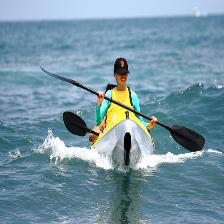

2: probability: 0.09, label: canoe



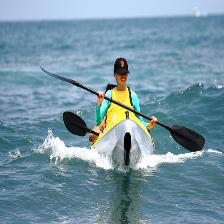

3: probability: 0.01, label: speedboat



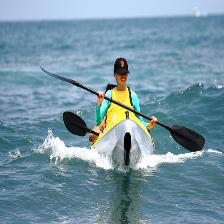

4: probability: 0.01, label: killer whale



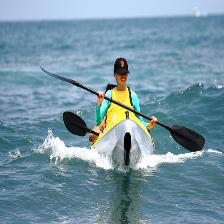

5: probability: 0.00, label: great white shark



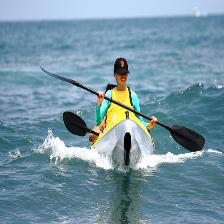

1: probability: 0.16, label: wreck



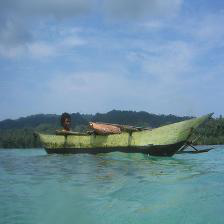

2: probability: 0.16, label: lakeside



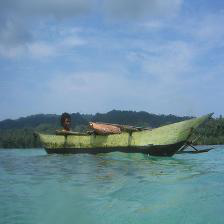

3: probability: 0.15, label: sandbar



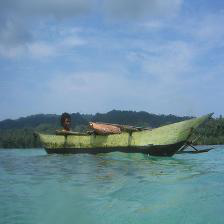

4: probability: 0.13, label: promontory



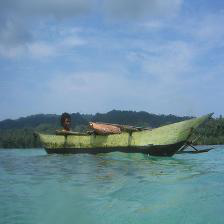

5: probability: 0.09, label: breakwater



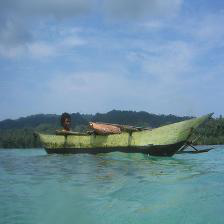

1: probability: 0.93, label: canoe



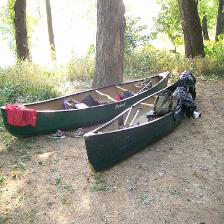

2: probability: 0.02, label: paddle



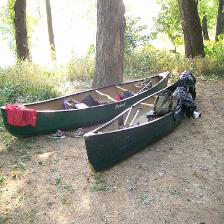

3: probability: 0.01, label: bobsled



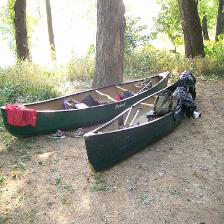

4: probability: 0.00, label: tub



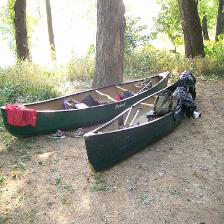

5: probability: 0.00, label: stretcher



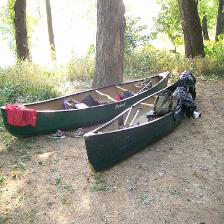

1: probability: 0.37, label: canoe



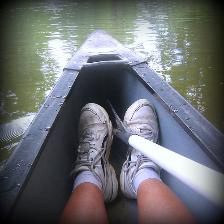

2: probability: 0.23, label: gondola



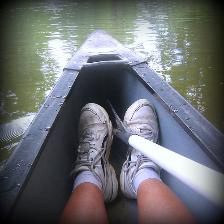

3: probability: 0.06, label: grey whale



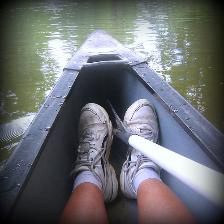

4: probability: 0.03, label: running shoe



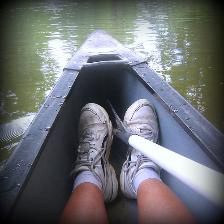

5: probability: 0.03, label: trimaran



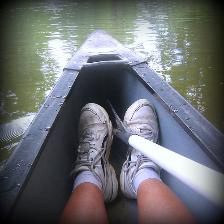

1: probability: 0.63, label: canoe



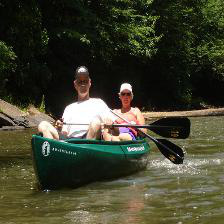

2: probability: 0.36, label: paddle



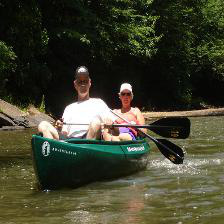

3: probability: 0.00, label: speedboat



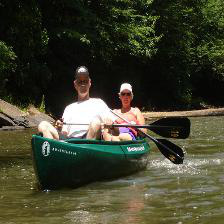

4: probability: 0.00, label: bobsled



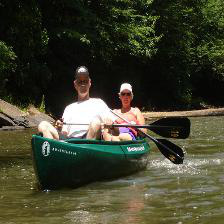

5: probability: 0.00, label: coho



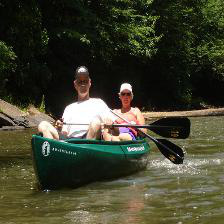

1: probability: 0.93, label: cassette



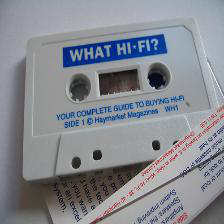

2: probability: 0.04, label: cassette player



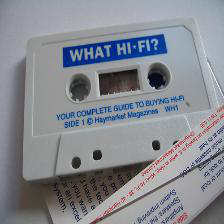

3: probability: 0.03, label: tape player



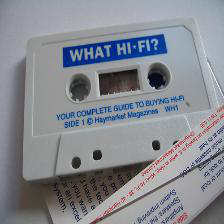

4: probability: 0.00, label: pencil sharpener



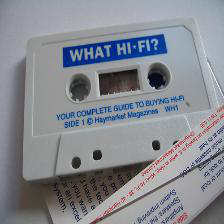

5: probability: 0.00, label: switch



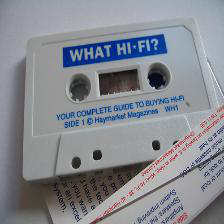

1: probability: 0.93, label: cassette



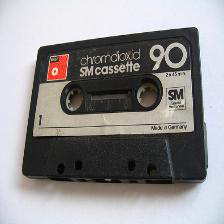

2: probability: 0.04, label: tape player



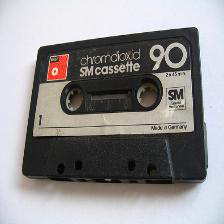

3: probability: 0.03, label: cassette player



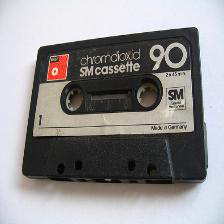

4: probability: 0.00, label: radio



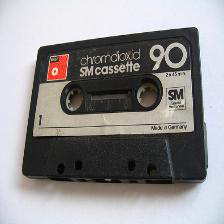

5: probability: 0.00, label: CD player



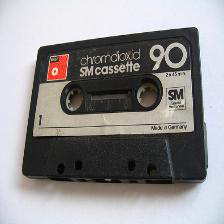

1: probability: 0.22, label: cassette



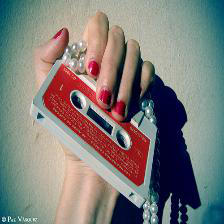

2: probability: 0.07, label: harmonica



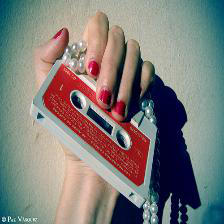

3: probability: 0.05, label: rubber eraser



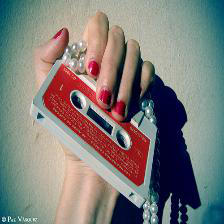

4: probability: 0.04, label: rule



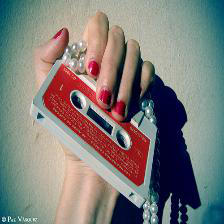

5: probability: 0.02, label: tape player



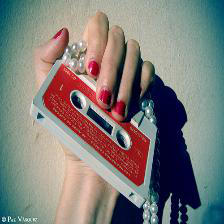

1: probability: 0.45, label: tape player



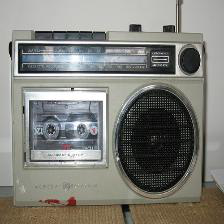

2: probability: 0.44, label: cassette player



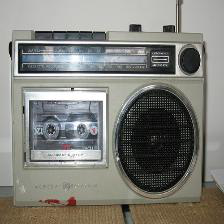

3: probability: 0.05, label: CD player



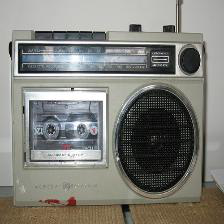

4: probability: 0.04, label: radio



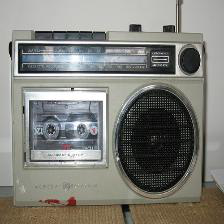

5: probability: 0.02, label: cassette



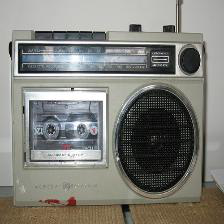

1: probability: 0.75, label: cassette



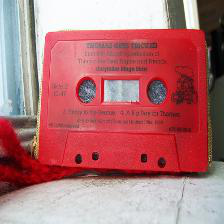

2: probability: 0.14, label: cassette player



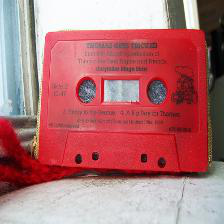

3: probability: 0.10, label: tape player



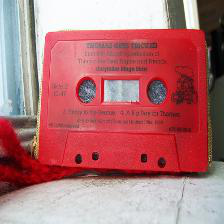

4: probability: 0.00, label: packet



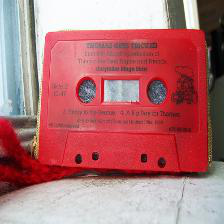

5: probability: 0.00, label: radio



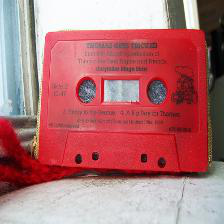

1: probability: 0.81, label: cup



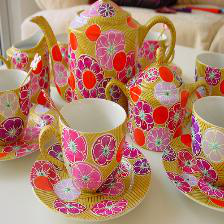

2: probability: 0.04, label: teapot



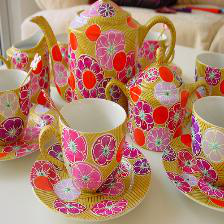

3: probability: 0.03, label: mixing bowl



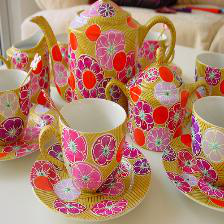

4: probability: 0.03, label: coffee mug



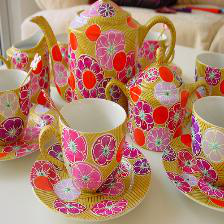

5: probability: 0.02, label: tray



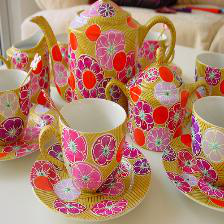

1: probability: 0.72, label: coffeepot



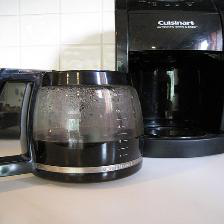

2: probability: 0.13, label: water jug



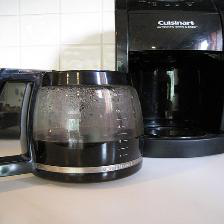

3: probability: 0.05, label: espresso maker



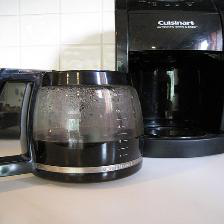

4: probability: 0.01, label: toaster



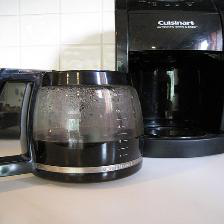

5: probability: 0.01, label: coffee mug



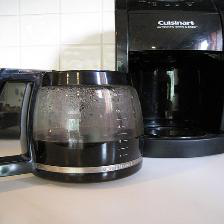

1: probability: 0.64, label: coffeepot



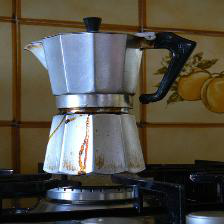

2: probability: 0.35, label: espresso maker



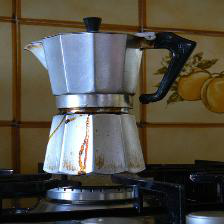

3: probability: 0.00, label: water jug



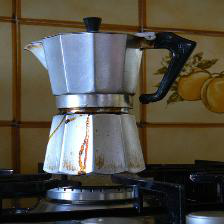

4: probability: 0.00, label: stove



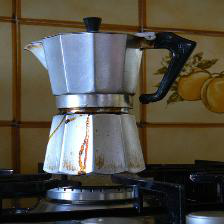

5: probability: 0.00, label: sewing machine



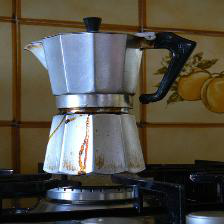

1: probability: 0.33, label: coffeepot



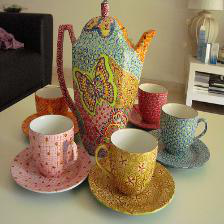

2: probability: 0.22, label: teapot



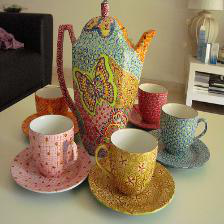

3: probability: 0.11, label: cup



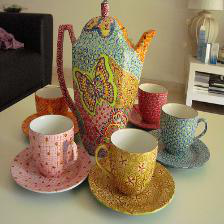

4: probability: 0.07, label: pitcher



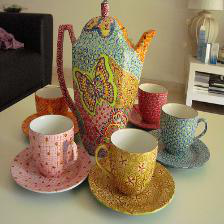

5: probability: 0.06, label: mixing bowl



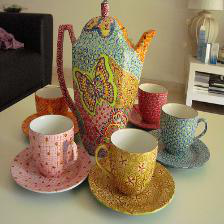

1: probability: 0.11, label: water bottle



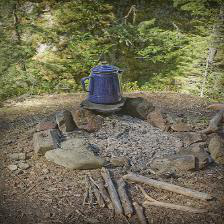

2: probability: 0.11, label: water jug



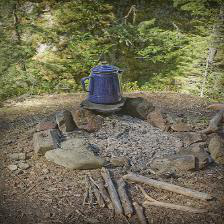

3: probability: 0.10, label: milk can



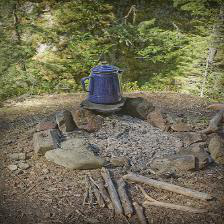

4: probability: 0.06, label: coffeepot



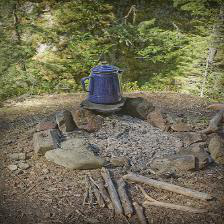

5: probability: 0.03, label: ashcan



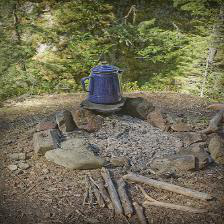

1: probability: 0.44, label: crib



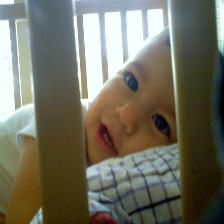

2: probability: 0.07, label: cradle



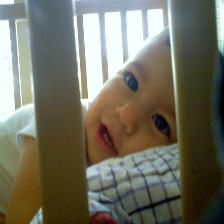

3: probability: 0.07, label: seat belt



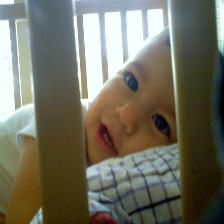

4: probability: 0.04, label: neck brace



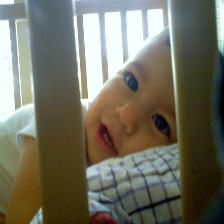

5: probability: 0.03, label: nipple



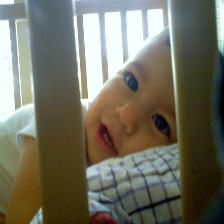

1: probability: 0.60, label: crib



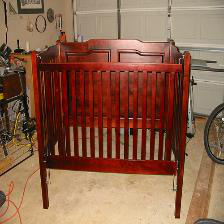

2: probability: 0.34, label: cradle



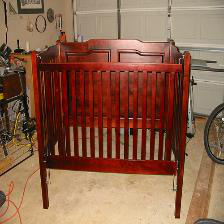

3: probability: 0.01, label: bassinet



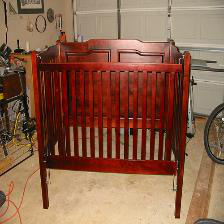

4: probability: 0.01, label: studio couch



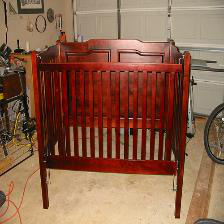

5: probability: 0.01, label: radiator



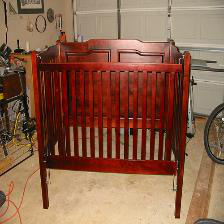

1: probability: 0.43, label: studio couch



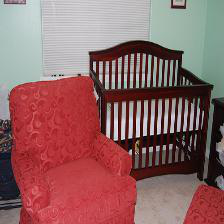

2: probability: 0.29, label: crib



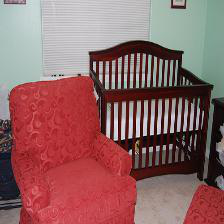

3: probability: 0.10, label: quilt



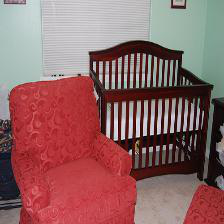

4: probability: 0.05, label: pillow



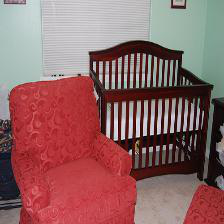

5: probability: 0.05, label: cradle



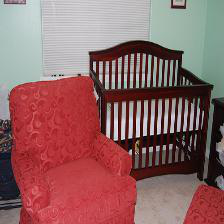

1: probability: 0.91, label: bassinet



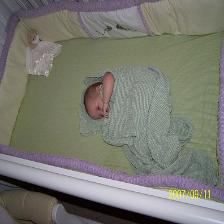

2: probability: 0.04, label: cradle



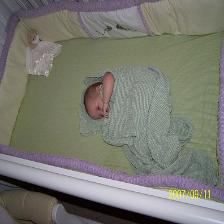

3: probability: 0.03, label: crib



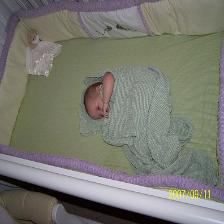

4: probability: 0.01, label: bath towel



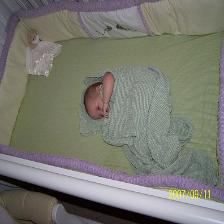

5: probability: 0.00, label: diaper



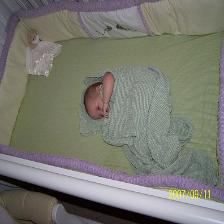

1: probability: 0.96, label: crib



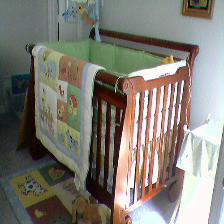

2: probability: 0.03, label: cradle



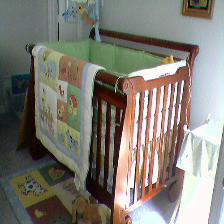

3: probability: 0.00, label: quilt



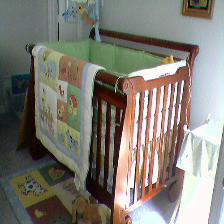

4: probability: 0.00, label: bassinet



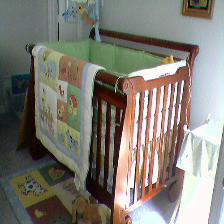

5: probability: 0.00, label: pillow



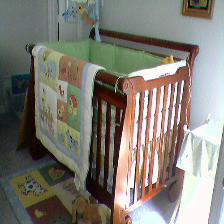

1: probability: 0.92, label: cucumber



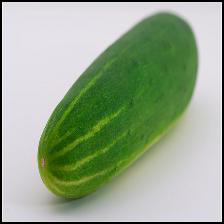

2: probability: 0.07, label: zucchini



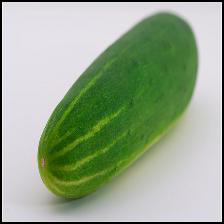

3: probability: 0.00, label: spaghetti squash



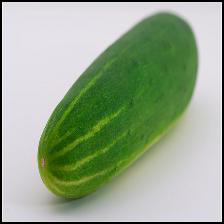

4: probability: 0.00, label: leafhopper



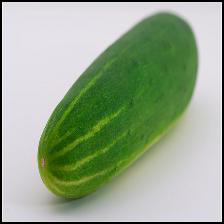

5: probability: 0.00, label: fig



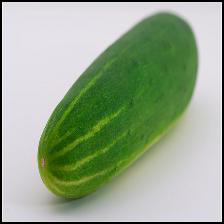

1: probability: 0.73, label: cucumber



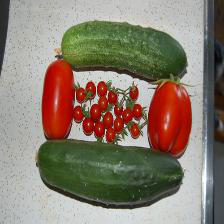

2: probability: 0.27, label: zucchini



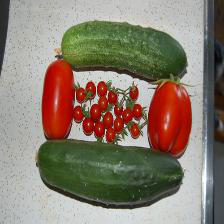

3: probability: 0.00, label: bell pepper



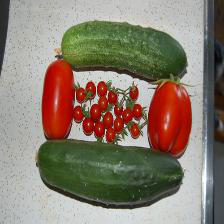

4: probability: 0.00, label: acorn squash



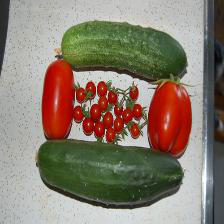

5: probability: 0.00, label: spaghetti squash



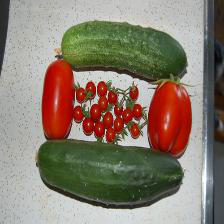

1: probability: 0.97, label: cucumber



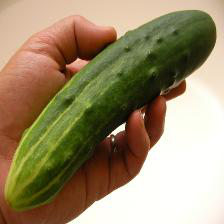

2: probability: 0.03, label: zucchini



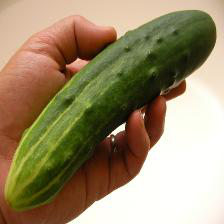

3: probability: 0.00, label: ear



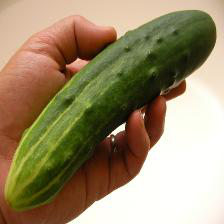

4: probability: 0.00, label: spaghetti squash



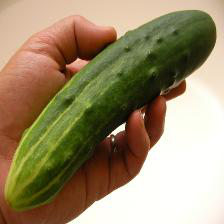

5: probability: 0.00, label: acorn squash



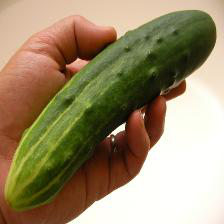

1: probability: 0.86, label: cucumber



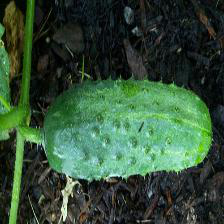

2: probability: 0.13, label: zucchini



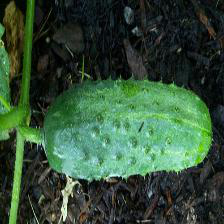

3: probability: 0.00, label: spaghetti squash



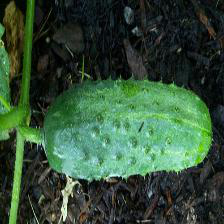

4: probability: 0.00, label: slug



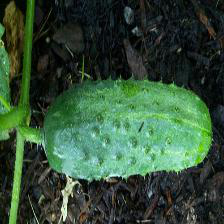

5: probability: 0.00, label: lacewing



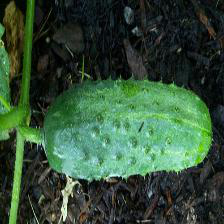

1: probability: 0.86, label: zucchini



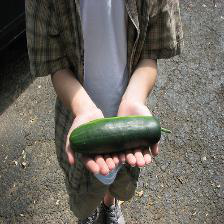

2: probability: 0.14, label: cucumber



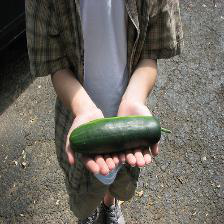

3: probability: 0.00, label: sea cucumber



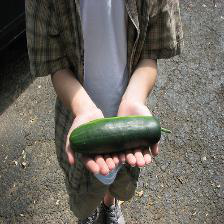

4: probability: 0.00, label: eel



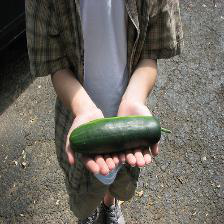

5: probability: 0.00, label: beer bottle



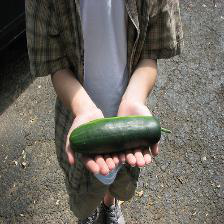

1: probability: 0.48, label: Labrador retriever



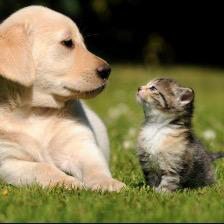

2: probability: 0.36, label: golden retriever



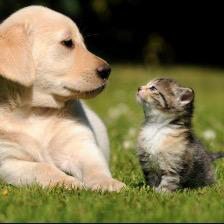

3: probability: 0.06, label: kuvasz



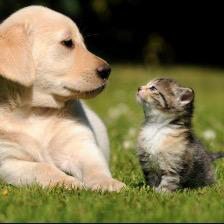

4: probability: 0.01, label: Great Pyrenees



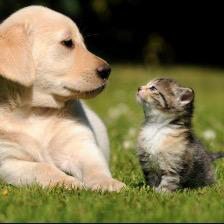

5: probability: 0.01, label: Cardigan



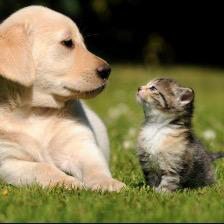

1: probability: 0.55, label: lemon



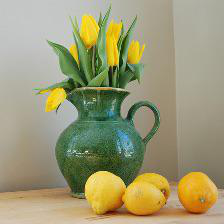

2: probability: 0.17, label: vase



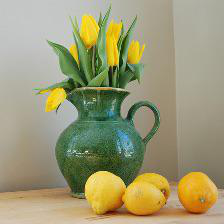

3: probability: 0.07, label: pitcher



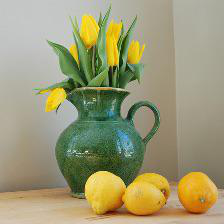

4: probability: 0.03, label: orange



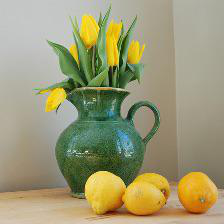

5: probability: 0.01, label: cucumber



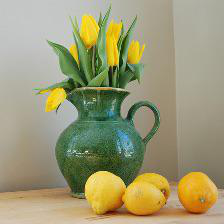

1: probability: 0.99, label: flute



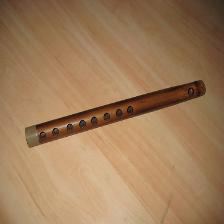

2: probability: 0.00, label: oboe



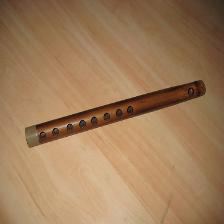

3: probability: 0.00, label: bassoon



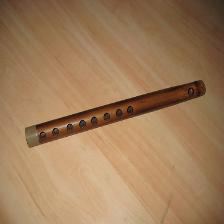

4: probability: 0.00, label: drumstick



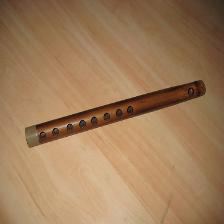

5: probability: 0.00, label: rule



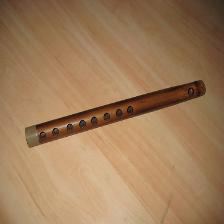

1: probability: 1.00, label: flute



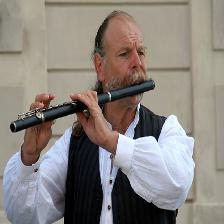

2: probability: 0.00, label: harmonica



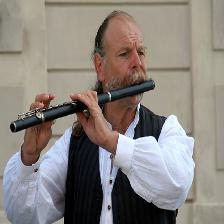

3: probability: 0.00, label: rifle



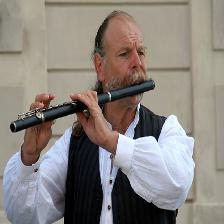

4: probability: 0.00, label: oboe



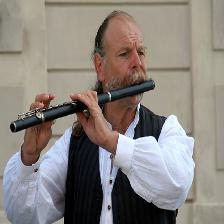

5: probability: 0.00, label: violin



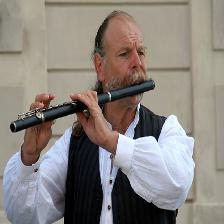

1: probability: 0.82, label: flute



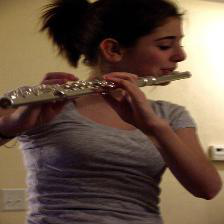

2: probability: 0.11, label: oboe



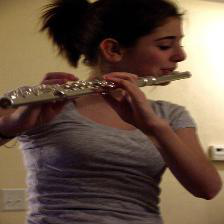

3: probability: 0.04, label: harmonica



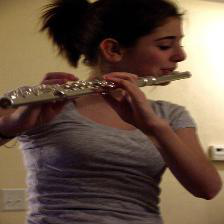

4: probability: 0.00, label: ocarina



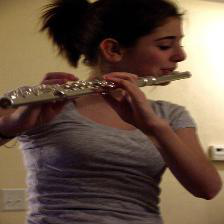

5: probability: 0.00, label: lipstick



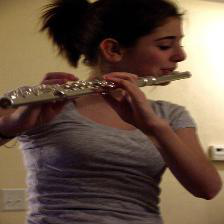

1: probability: 0.28, label: cornet



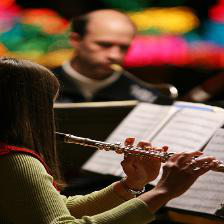

2: probability: 0.22, label: trombone



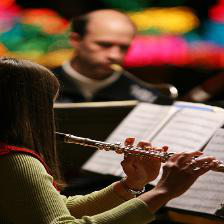

3: probability: 0.18, label: flute



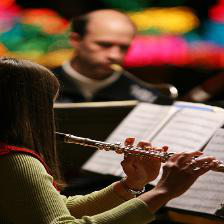

4: probability: 0.12, label: oboe



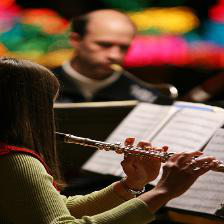

5: probability: 0.08, label: bassoon



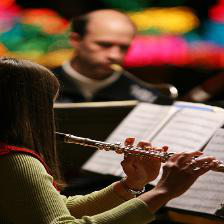

1: probability: 0.96, label: flute



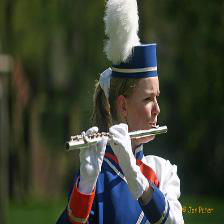

2: probability: 0.02, label: harmonica



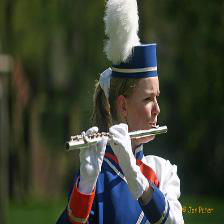

3: probability: 0.00, label: bow



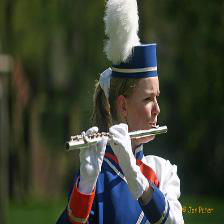

4: probability: 0.00, label: cornet



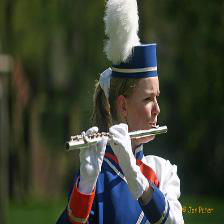

5: probability: 0.00, label: panpipe



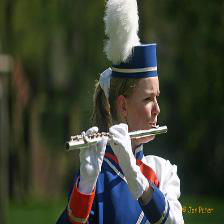

1: probability: 1.00, label: forklift



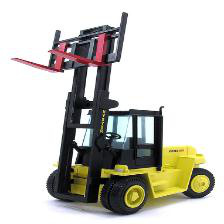

2: probability: 0.00, label: harvester



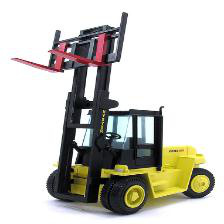

3: probability: 0.00, label: tractor



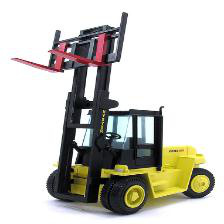

4: probability: 0.00, label: crane



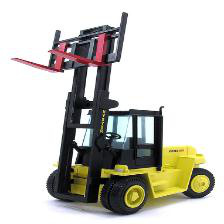

5: probability: 0.00, label: lawn mower



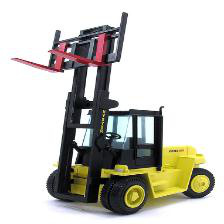

1: probability: 1.00, label: forklift



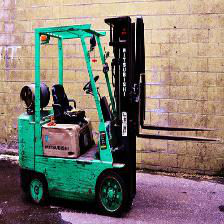

2: probability: 0.00, label: golfcart



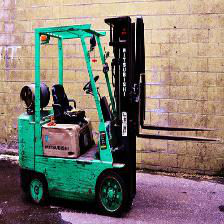

3: probability: 0.00, label: go-kart



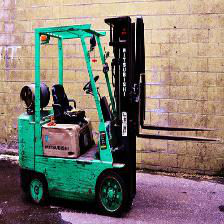

4: probability: 0.00, label: lawn mower



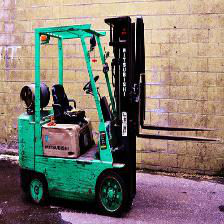

5: probability: 0.00, label: tractor



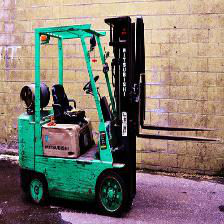

1: probability: 0.91, label: forklift



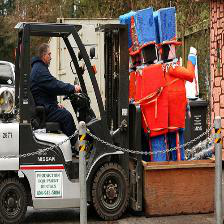

2: probability: 0.06, label: golfcart



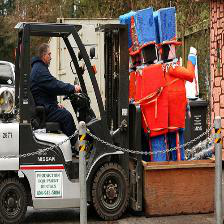

3: probability: 0.01, label: tractor



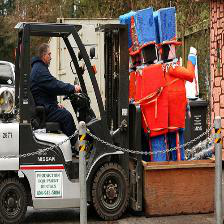

4: probability: 0.00, label: harvester



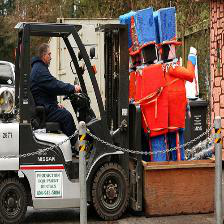

5: probability: 0.00, label: Model T



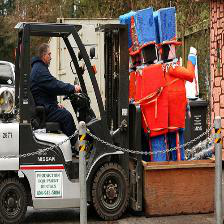

1: probability: 0.88, label: forklift



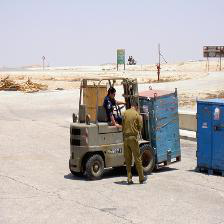

2: probability: 0.02, label: garbage truck



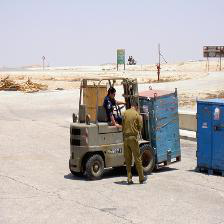

3: probability: 0.01, label: tow truck



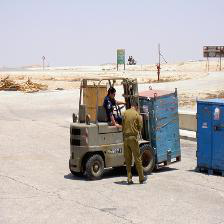

4: probability: 0.01, label: golfcart



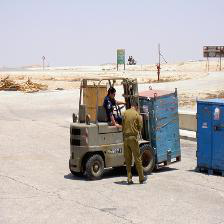

5: probability: 0.01, label: tractor



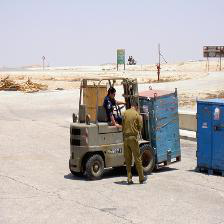

1: probability: 0.85, label: forklift



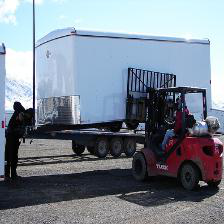

2: probability: 0.09, label: trailer truck



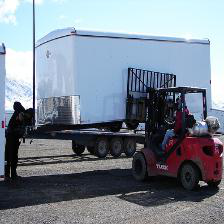

3: probability: 0.02, label: tow truck



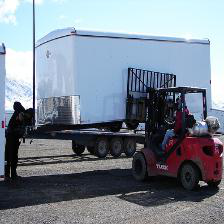

4: probability: 0.01, label: garbage truck



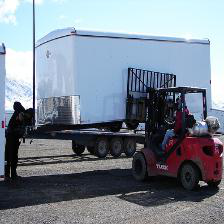

5: probability: 0.01, label: crane



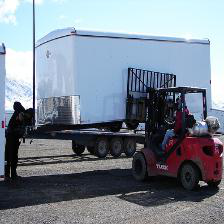

1: probability: 0.89, label: hen



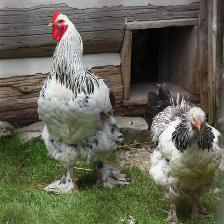

2: probability: 0.11, label: cock



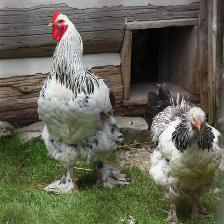

3: probability: 0.00, label: partridge



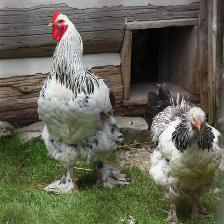

4: probability: 0.00, label: ruffed grouse



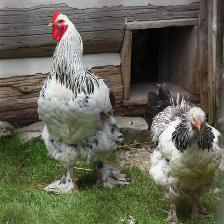

5: probability: 0.00, label: black swan



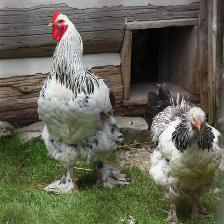

1: probability: 0.96, label: hen



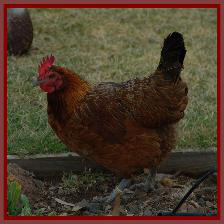

2: probability: 0.04, label: cock



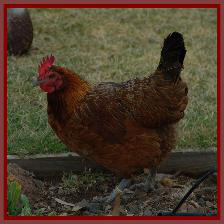

3: probability: 0.00, label: partridge



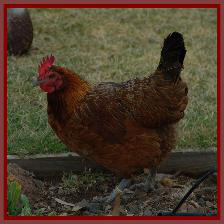

4: probability: 0.00, label: ruffed grouse



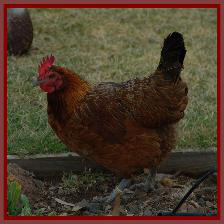

5: probability: 0.00, label: prairie chicken



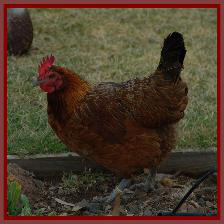

1: probability: 0.79, label: hen



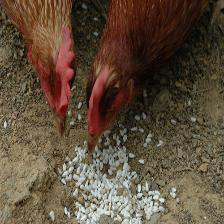

2: probability: 0.20, label: cock



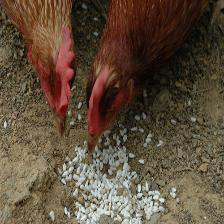

3: probability: 0.00, label: house finch



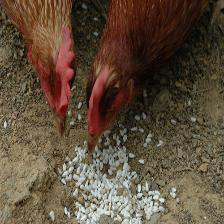

4: probability: 0.00, label: echidna



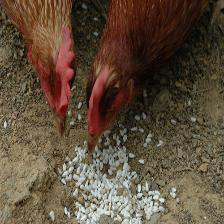

5: probability: 0.00, label: vulture



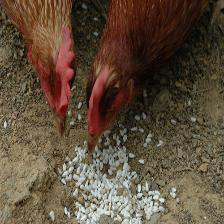

1: probability: 0.65, label: hen



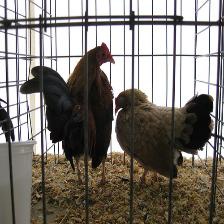

2: probability: 0.19, label: cock



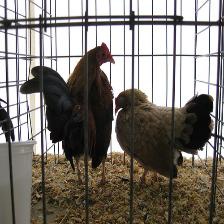

3: probability: 0.06, label: European gallinule



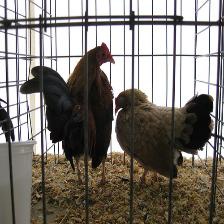

4: probability: 0.02, label: vulture



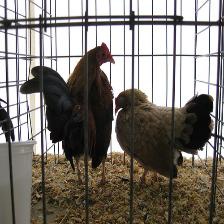

5: probability: 0.01, label: partridge



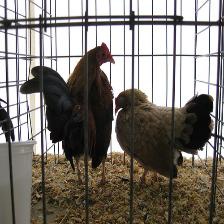

1: probability: 0.53, label: hen



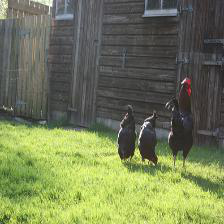

2: probability: 0.28, label: cock



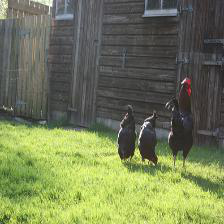

3: probability: 0.06, label: peacock



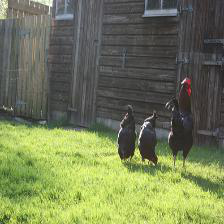

4: probability: 0.03, label: partridge



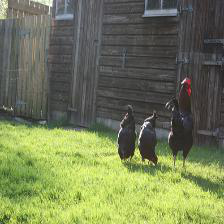

5: probability: 0.02, label: drake



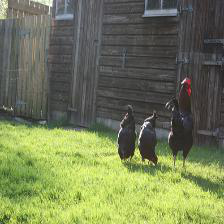

1: probability: 1.00, label: nematode



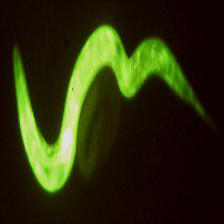

2: probability: 0.00, label: vine snake



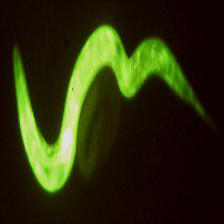

3: probability: 0.00, label: oscilloscope



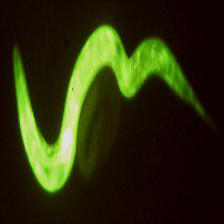

4: probability: 0.00, label: velvet



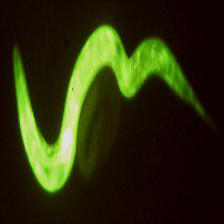

5: probability: 0.00, label: night snake



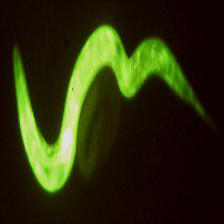

1: probability: 1.00, label: nematode



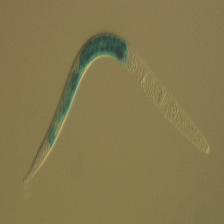

2: probability: 0.00, label: letter opener



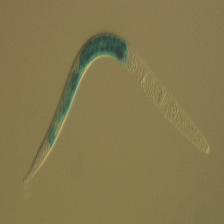

3: probability: 0.00, label: sea snake



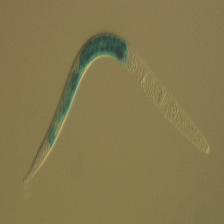

4: probability: 0.00, label: gar



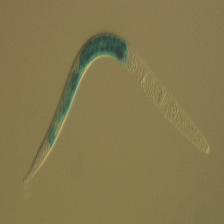

5: probability: 0.00, label: eel



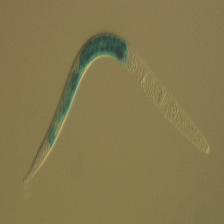

1: probability: 0.98, label: nematode


2: probability: 0.00, label: grey whale


3: probability: 0.00, label: velvet


4: probability: 0.00, label: isopod


5: probability: 0.00, label: gar


1: probability: 1.00, label: nematode


2: probability: 0.00, label: rule


3: probability: 0.00, label: slide rule


4: probability: 0.00, label: gar


5: probability: 0.00, label: lacewing


1: probability: 1.00, label: nematode


2: probability: 0.00, label: velvet


3: probability: 0.00, label: grey whale


4: probability: 0.00, label: spotlight


5: probability: 0.00, label: stove


1: probability: 0.97, label: screwdriver


2: probability: 0.01, label: ballpoint


3: probability: 0.00, label: letter opener


4: probability: 0.00, label: hair slide


5: probability: 0.00, label: syringe


1: probability: 0.35, label: screwdriver


2: probability: 0.16, label: paintbrush


3: probability: 0.10, label: quill


4: probability: 0.06, label: pelican


5: probability: 0.04, label: letter opener


1: probability: 0.87, label: screwdriver


2: probability: 0.02, label: syringe


3: probability: 0.01, label: carpenter's kit


4: probability: 0.01, label: spindle


5: probability: 0.01, label: swab


1: probability: 0.99, label: screwdriver


2: probability: 0.00, label: syringe


3: probability: 0.00, label: ice lolly


4: probability: 0.00, label: paintbrush


5: probability: 0.00, label: plunger


1: probability: 0.51, label: screwdriver


2: probability: 0.07, label: letter opener


3: probability: 0.05, label: swab


4: probability: 0.05, label: hammer


5: probability: 0.03, label: bow


1: probability: 0.99, label: water bottle


2: probability: 0.01, label: water jug


3: probability: 0.00, label: pop bottle


4: probability: 0.00, label: nipple


5: probability: 0.00, label: beaker


1: probability: 0.34, label: water jug


2: probability: 0.24, label: vacuum


3: probability: 0.22, label: water bottle


4: probability: 0.02, label: plunger


5: probability: 0.02, label: nipple


1: probability: 0.26, label: miniature pinscher


2: probability: 0.16, label: black-and-tan coonhound


3: probability: 0.11, label: Doberman


4: probability: 0.10, label: basset


5: probability: 0.08, label: Rottweiler


1: probability: 0.66, label: water bottle


2: probability: 0.08, label: beer bottle


3: probability: 0.03, label: pop bottle


4: probability: 0.02, label: pill bottle


5: probability: 0.02, label: wine bottle


1: probability: 0.42, label: water bottle


2: probability: 0.19, label: pill bottle


3: probability: 0.07, label: hair spray


4: probability: 0.04, label: pop bottle


5: probability: 0.04, label: syringe


In [21]:
layers = ['mixed3a', 'mixed3b', 'mixed4a', 'mixed4b', 'mixed4c', 'mixed4d', 'mixed4e', 'mixed5a', 'mixed5b']
cur_labels = get_top_five()
for label in cur_labels:
    # Note: Must save the file off each time because it will not re-read raw ndarray
    img = resize(load(label.pop(0)), (224, 224))  # Make all 224x224
    imsave("current.jpeg", img, plugin='pil', format_str='jpeg')
    img = load("current.jpeg")
    for tag in label:
        print(tag)
        saliency_layers = []
        saliency_values = []
        for layer in layers:
            # Get our saliency layer
            saliency = orange_blue(
              raw_class_spatial_attr(img, layer, tag.split(':')[-1].strip(), override=None),
              raw_class_spatial_attr(img, layer, None, override=None),
              clip=True
            )
            saliency_layers.append(saliency[0])
            saliency_values.append(saliency[1])

            attrs = raw_spatial_spatial_attr(img, layer, "mixed5b", override=None)
            attrs = attrs / attrs.max()

        lucid_svelte.SpatialWidget({
        "spritemap1": image_url_grid(attrs),
        "spritemap2": image_url_grid(attrs.transpose(2,3,0,1)),
        "size1": attrs.shape[3],
        "layer1": layer,
        "size2": attrs.shape[0],
        "layer2": layer,
        "img" : _image_url(img),
        "hint1": _image_url(saliency_layers[0]),
        "hint2": _image_url(saliency_layers[1]),
        "hint3": _image_url(saliency_layers[2]),
        "hint4": _image_url(saliency_layers[3]),
        "hint5": _image_url(saliency_layers[4]),
        "hint6": _image_url(saliency_layers[5]),
        "hint7": _image_url(saliency_layers[6]),
        "hint8": _image_url(saliency_layers[7]),
        "hint9": _image_url(saliency_layers[8]),
        "pct1": saliency_values[0] * 100,
        "pct2": saliency_values[1] * 100,
        "pct3": saliency_values[2] * 100,
        "pct4": saliency_values[3] * 100,
        "pct5": saliency_values[4] * 100,
        "pct6": saliency_values[5] * 100,
        "pct7": saliency_values[6] * 100,
        "pct8": saliency_values[7] * 100,
        "pct9": saliency_values[8] * 100
        })